In [9]:
import numpy as np
from matplotlib import pyplot as plt

from bounding_box_utils.bounding_box_utils import iou

from object_detection_2d_data_generator import DataGenerator
from transformations.object_detection_2d_patch_sampling_ops import *
from transformations.object_detection_2d_geometric_ops import *
from transformations.object_detection_2d_photometric_ops import *
from transformations.object_detection_2d_image_boxes_validation_utils import *
from data_augmentation_chains.data_augmentation_chain_original_ssd import *

%matplotlib inline

In [10]:
dataset = DataGenerator(labels_output_format=('class_id', 'xmin', 'ymin', 'xmax', 'ymax'))

In [11]:
images_dir         = '/home/omr/Desktop/final_project/img/iii/'
annotations_dir  = '/home/omr/Desktop/final_project/img/aaa/'
image_set_filename = '/home/omr/Desktop/final_project/img/img.txt'
image_gen_dir = '/home/omr/Desktop/final_project/gen/'

# The XML parser needs to now what object class names to look for and in which order to map them to integers.
classes = ['Iron_Man',
'Captain_America',
'Thor',
'Hulk',
'Black_Widow',
'Hawkeye',
'Rocket_Raccoon',
'Groot'
]



In [12]:
dd = dataset.parse_xml(images_dirs=[images_dir],
                      image_set_filenames=[image_set_filename],
                      annotations_dirs=[annotations_dir],
                      classes=classes,
                      include_classes='all',
                      exclude_truncated=False,
                      exclude_difficult=False,
                      ret=True)

img.txt: 100%|██████████| 22/22 [00:00<00:00, 730.58it/s]


In [88]:
label_num = 500
class_num = [0]*8
# for i in [24, 25, 26, 54, 55, 56, 76, 77, 78, 79, 82]:
#     class_num[i] = label_num
txt = []

for j in range(len(dd[1])):
    for a in dd[1][j]:
        class_num[a[0]] += 1
    txt.append(dd[2][j])
    
for i, n in enumerate(class_num):
    print(classes[i], ':', n)

Iron_Man : 6
Captain_America : 5
Thor : 3
Hulk : 4
Black_Widow : 6
Hawkeye : 6
Rocket_Raccoon : 6
Groot : 6


In [89]:
image_validator = ImageValidator(overlap_criterion='area',
                                 bounds=(0.3, 1.0),
                                 n_boxes_min=1)

box_filter = BoxFilter(overlap_criterion='area',
                       overlap_bounds=(0.8, 1.0))

random_translate = RandomTranslate(dy_minmax=(0.03,0.2),
                                   dx_minmax=(0.03,0.2),
                                   prob=0.8,
                                   clip_boxes=False,
                                   box_filter=box_filter,
                                   image_validator=image_validator,
                                   n_trials_max=3)

# Utility transformations
convert_to_3_channels = ConvertTo3Channels() # Make sure all images end up having 3 channels.
convert_RGB_to_HSV    = ConvertColor(current='RGB', to='HSV')
convert_HSV_to_RGB    = ConvertColor(current='HSV', to='RGB')
convert_to_float32    = ConvertDataType(to='float32')
convert_to_uint8      = ConvertDataType(to='uint8')
resize                = Resize(height=350, width=500)

# Photometric transformations
random_brightness     = RandomBrightness(lower=-30, upper=30, prob=0.5)
random_contrast       = RandomContrast(lower=0.8, upper=1.2, prob=0.5)
random_saturation     = RandomSaturation(lower=0.9, upper=1.1, prob=0.5)
random_hue            = RandomHue(max_delta=12, prob=0.5)

# Geometric transformations
random_flip           = RandomFlip(dim='horizontal', prob=0.5)

patch_coord_generator = PatchCoordinateGenerator(must_match='w_ar',
                                                 min_scale=1.0,
                                                 max_scale=1.3,
                                                 scale_uniformly=False,
                                                 min_aspect_ratio = 0.8,
                                                 max_aspect_ratio = 1.3)

random_patch          = RandomPatch(patch_coord_generator=patch_coord_generator,
                                    box_filter=box_filter,
                                    image_validator=image_validator,
                                    n_trials_max=10,
                                    clip_boxes=False,
                                    prob=1.0,
                                    can_fail=False)

# Define the processing chain
data_augmentation = [convert_to_3_channels,
                     convert_to_float32,
                     random_brightness,
                     random_contrast,
                     convert_to_uint8,
                     convert_RGB_to_HSV,
                     convert_to_float32,
                     random_saturation,
                     random_hue,
                     convert_to_uint8,
                     convert_HSV_to_RGB,
                     random_patch,
                     random_translate,
                     random_flip,
                     resize]
batch_size = 22
data_generator = dataset.generate(batch_size=batch_size,
                                  shuffle=False,
                                  transformations=data_augmentation,
                                  label_encoder=None,
                                  returns={'processed_images',
                                           'processed_labels',
                                           'filenames',
                                           'original_images',
                                           'original_labels'},
                                  keep_images_without_gt=False)

# data_generator = dataset.generate(batch_size=batch_size,
#                                   shuffle=False,
#                                   transformations=[random_patch, resize],
#                                   label_encoder=None,
#                                   returns={'processed_images',
#                                            'processed_labels',
#                                            'filenames',
#                                            'original_images',
#                                            'original_labels'},
#                                   keep_images_without_gt=False)


0
(720, 1280, 3)
(350, 500, 3)
1
(720, 1280, 3)
(350, 500, 3)
2
(720, 1280, 3)
(350, 500, 3)
3
(720, 1280, 3)
(350, 500, 3)
4
(720, 1280, 3)
(350, 500, 3)
5
(720, 1280, 3)
(350, 500, 3)
6
(720, 1280, 3)
(350, 500, 3)
7
(720, 1280, 3)
(350, 500, 3)
8
(720, 1280, 3)
(350, 500, 3)
9
(720, 1280, 3)
(350, 500, 3)
10
(720, 1280, 3)
(350, 500, 3)
11
(720, 1280, 3)
(350, 500, 3)
12
(720, 1280, 3)
(350, 500, 3)
13
(720, 1280, 3)
(350, 500, 3)
14
(720, 1280, 3)
(350, 500, 3)
15
(720, 1280, 3)
(350, 500, 3)
16
(720, 1280, 3)
(350, 500, 3)
17
(720, 1280, 3)
(350, 500, 3)
18
(720, 1280, 3)
(350, 500, 3)
19
(720, 1280, 3)
(350, 500, 3)


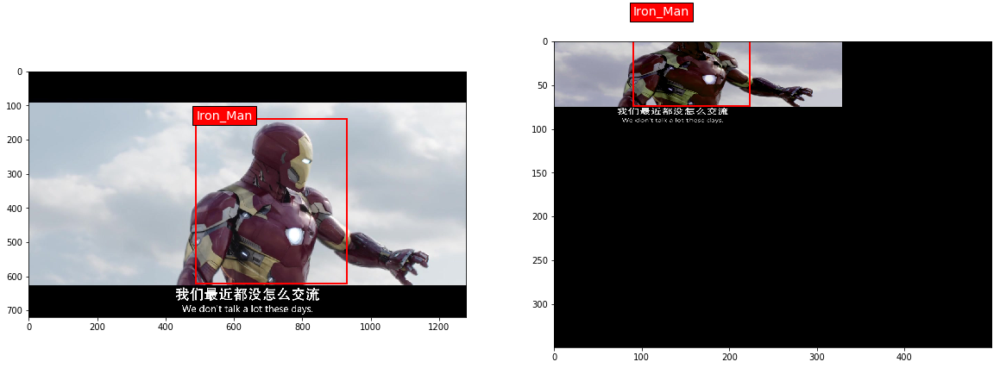

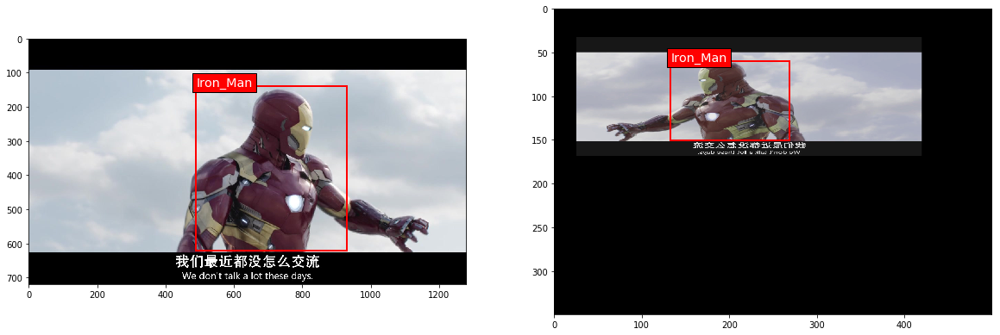

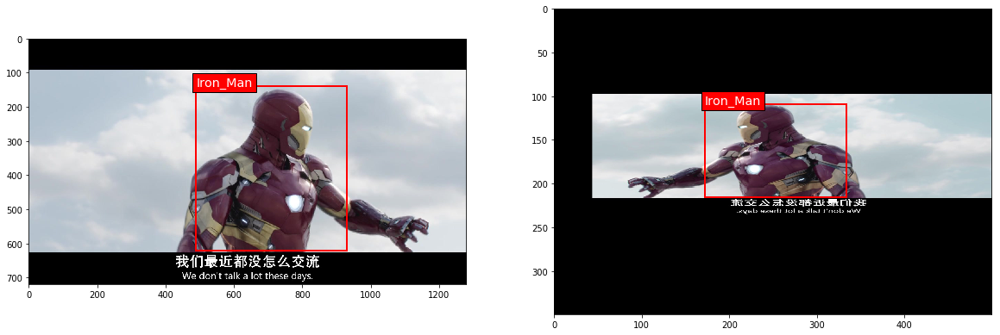

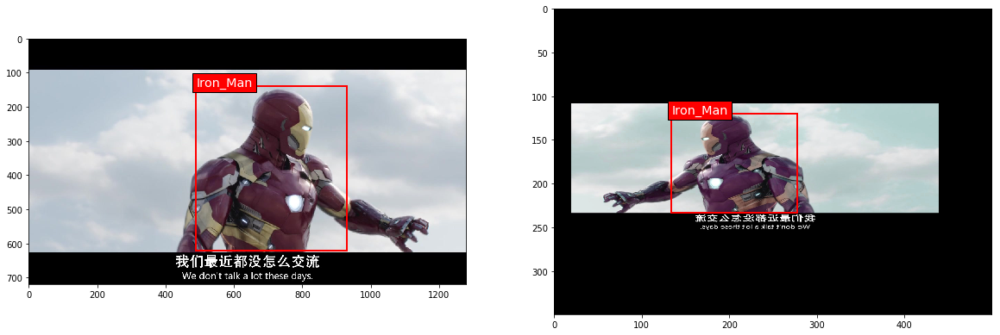

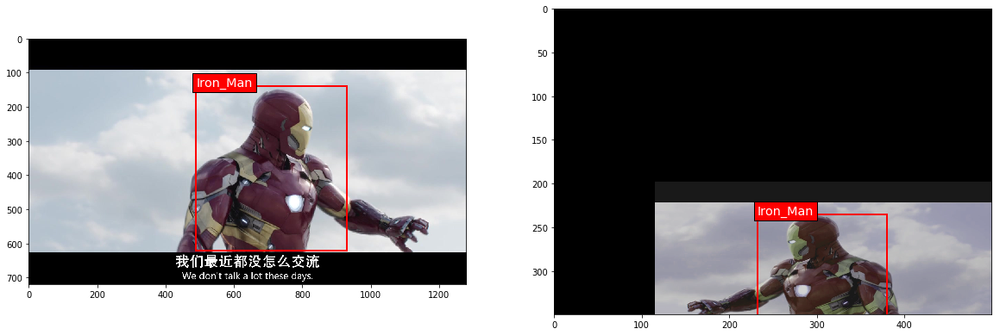

...

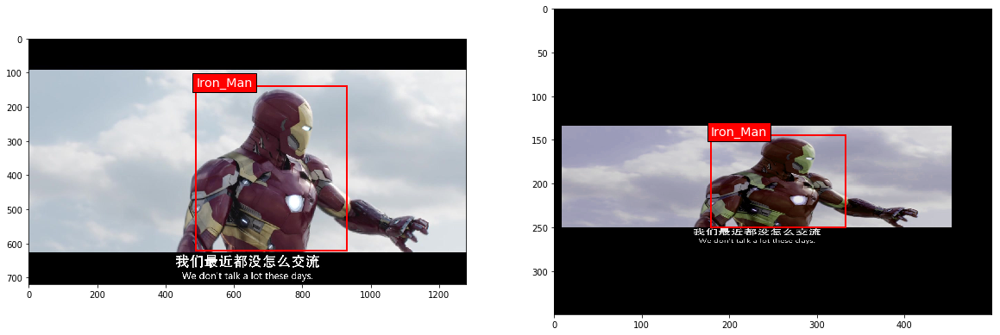

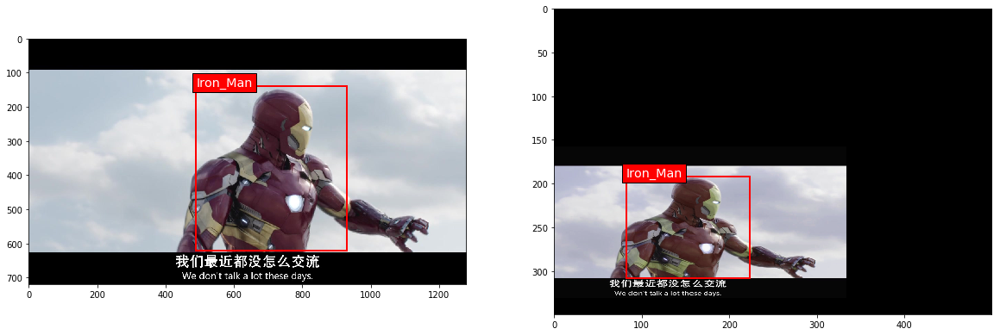

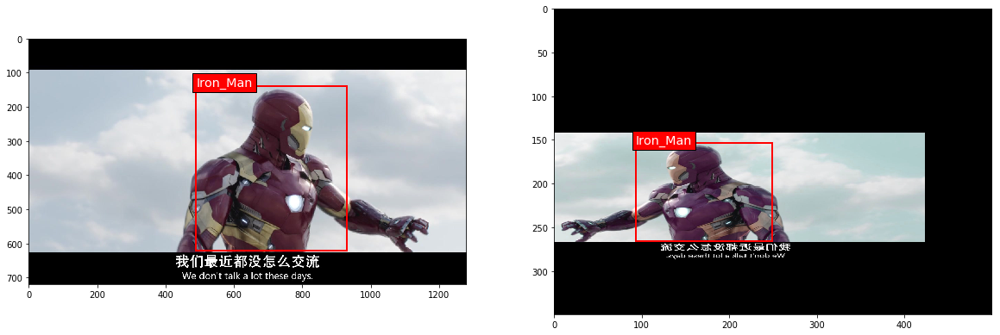

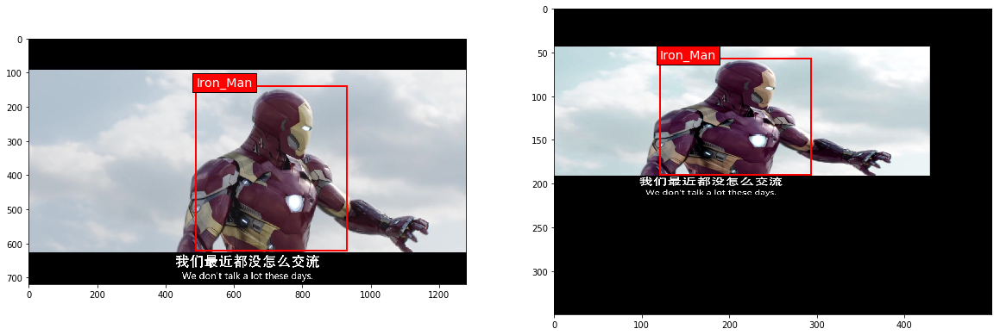

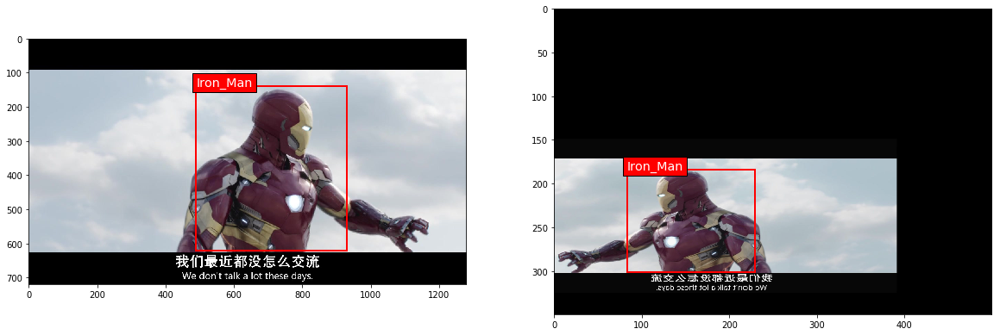

In [61]:
# test xxxxxxxx

for i in range(20):
    processed_images, processed_annotations, filenames, original_images, original_annotations = next(data_generator)
    ii = 0
    colors = plt.cm.hsv(np.linspace(0, 1, len(classes))).tolist() # Set the colors for the bounding boxes

    fig, cell = plt.subplots(1, 2, figsize=(20,16))
    cell[0].imshow(original_images[ii])
    cell[1].imshow(processed_images[ii])
    print(i)
    print(original_images[ii].shape)
    print(processed_images[ii].shape)
    
    for box in original_annotations[ii]:
        xmin = box[1]
        ymin = box[2]
        xmax = box[3]
        ymax = box[4]
        color = colors[int(box[0])]
        label = '{}'.format(classes[int(box[0])])
        cell[0].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
        cell[0].text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})

    for box in processed_annotations[ii]:
        xmin = box[1]
        ymin = box[2]
        xmax = box[3]
        ymax = box[4]
        color = colors[int(box[0])]
        label = '{}'.format(classes[int(box[0])])
        cell[1].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
        cell[1].text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})
        

0
(720, 1280, 3)
(350, 500, 3)
1
(1440, 2560, 3)
(350, 500, 3)
2
(720, 1280, 3)
(350, 500, 3)
3
(432, 820, 3)
(350, 500, 3)
4
(924, 1386, 3)
(350, 500, 3)
5
(2500, 4000, 3)
(350, 500, 3)
6
(675, 1200, 3)
(350, 500, 3)
7
(797, 1275, 3)
(350, 500, 3)
8
(1080, 1920, 3)
(350, 500, 3)
9
(720, 1280, 3)
(350, 500, 3)
10
(820, 1230, 3)
(350, 500, 3)
11
(900, 1600, 3)
(350, 500, 3)
12
(902, 1600, 3)
(350, 500, 3)
13
(442, 860, 3)
(350, 500, 3)
14
(1080, 1920, 3)
(350, 500, 3)
15
(1152, 2048, 3)
(350, 500, 3)
16
(1136, 2150, 3)
(350, 500, 3)
17
(1728, 2765, 3)
(350, 500, 3)
18
(450, 600, 3)
(350, 500, 3)
19
(1280, 1920, 3)
(350, 500, 3)
20
(576, 1024, 3)
(350, 500, 3)
21
(720, 1280, 3)
(350, 500, 3)


/home/omr/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


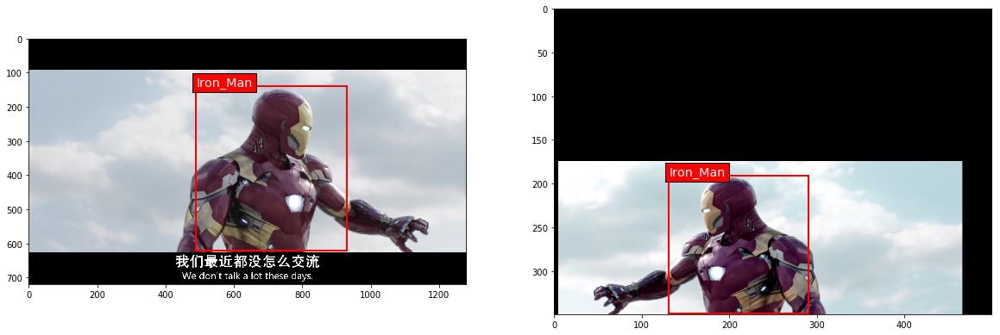

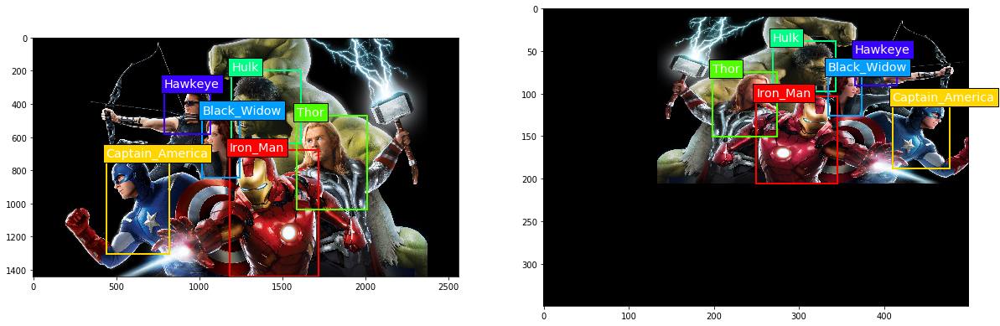

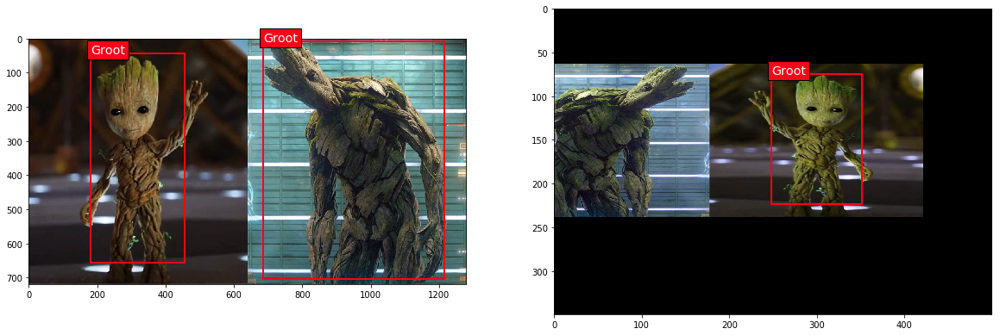

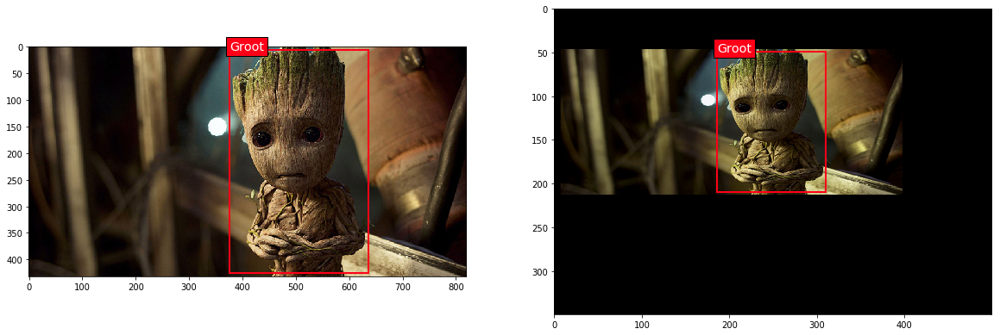

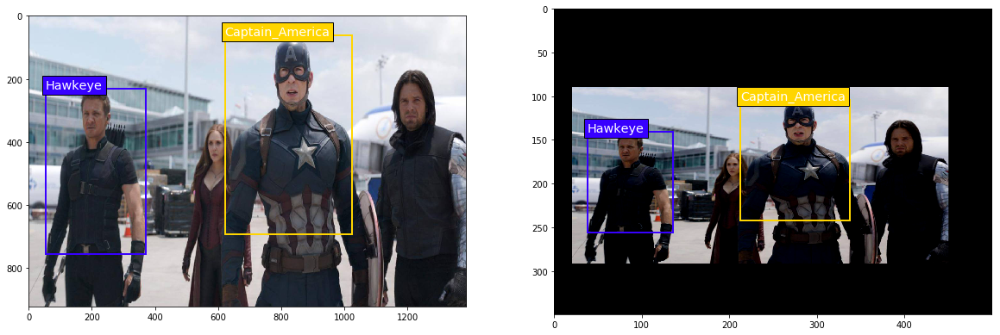

...

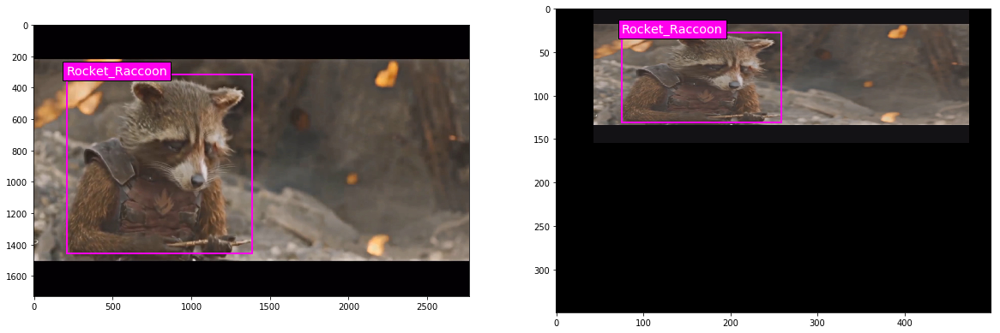

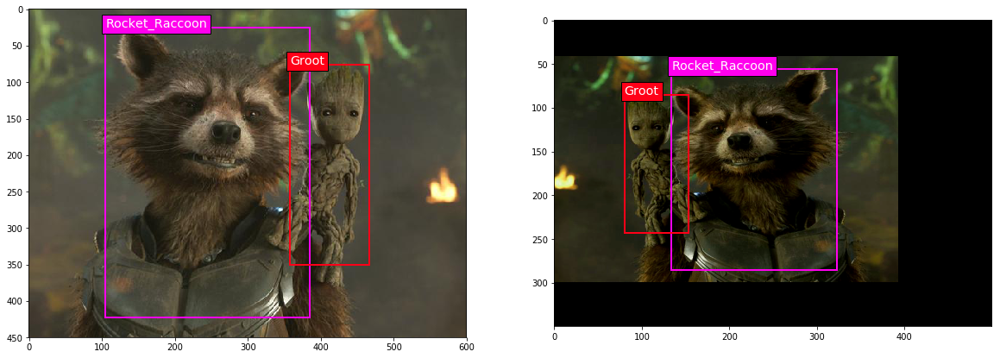

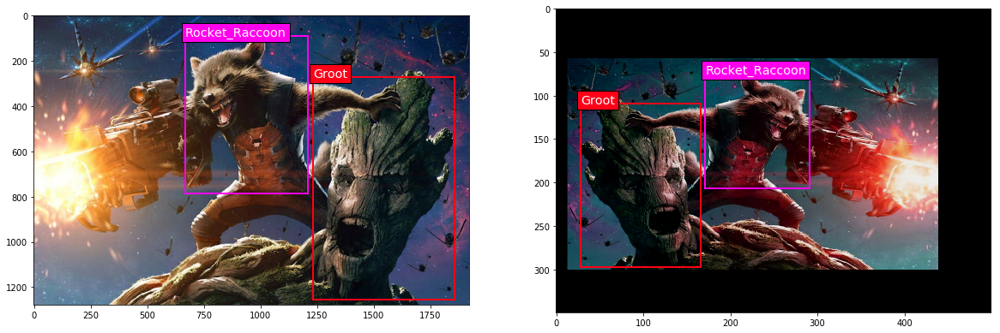

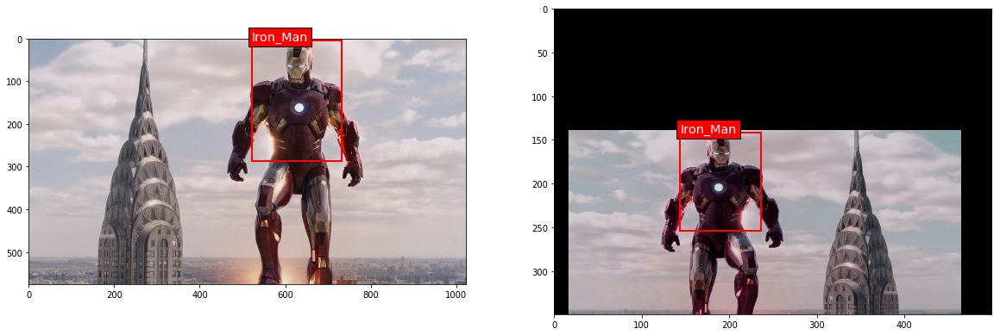

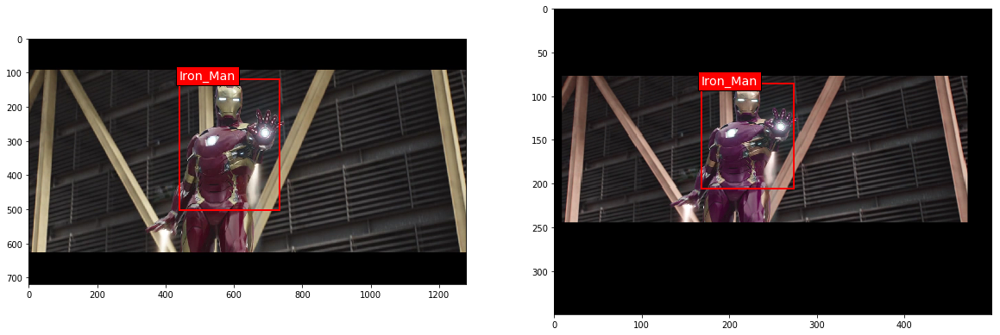

In [80]:
# test

import pandas as pd
import cv2

nname = 0
while True:
    processed_images, processed_annotations, filenames, original_images, original_annotations = next(data_generator)
    for j in range(len(processed_images)):
        img = np.array(processed_images[j])
        
        cv2.imwrite(image_gen_dir + str(nname) + ".jpg", cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
        for a in processed_annotations[j]:
            class_num[a[0]] += 1
            labels.append([str(nname)+".jpg", img.shape[1], img.shape[0], classes[a[0]], a[1], a[2], a[3], a[4]]) 
        nname += 1
        colors = plt.cm.hsv(np.linspace(0, 1, len(classes))).tolist() # Set the colors for the bounding boxes

        fig, cell = plt.subplots(1, 2, figsize=(20,16))
        cell[0].imshow(original_images[j])
        cell[1].imshow(processed_images[j])
#         fig.savefig(image_gen_dir + str(nname)+".jpg", format='jpg', transparent=True)
        print(j)
        print(original_images[j].shape)
        print(processed_images[j].shape)

        for box in original_annotations[j]:
            xmin = box[1]
            ymin = box[2]
            xmax = box[3]
            ymax = box[4]
            color = colors[int(box[0])]
            label = '{}'.format(classes[int(box[0])])
            cell[0].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
            cell[0].text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})

        for box in processed_annotations[j]:
            xmin = box[1]
            ymin = box[2]
            xmax = box[3]
            ymax = box[4]
            color = colors[int(box[0])]
            label = '{}'.format(classes[int(box[0])])
            cell[1].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
            cell[1].text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})
    break

In [90]:
import pandas as pd
import cv2

labels = []
class_num = [0]*8

nname = 0
i = 0
while True:
    print(i)
    processed_images, processed_annotations, filenames, original_images, original_annotations = next(data_generator)
    for j in range(len(processed_images)):
        if len(processed_annotations[j]) > 0:
            img = np.array(processed_images[j])
            cv2.imwrite(image_gen_dir + str(nname) + ".jpg", cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
            for a in processed_annotations[j]:
                class_num[a[0]] += 1
                labels.append([str(nname)+".jpg", img.shape[1], img.shape[0], classes[a[0]], a[1], a[2], a[3], a[4]]) 
            nname += 1
    i += 1        
    
    if i >= 1000:
        break
#         for j in range(len(original_images)):
#         if len(original_annotations[j]) > 0:
#             img = np.array(original_images[j])
#             cv2.imwrite(image_gen_dir + str(nname) + ".jpg", img)
#             for a in original_annotations[j]:
#                 class_num[a[0]] += 1
#                 labels.append([str(nname)+".jpg", img.shape[1], img.shape[0], classes[a[0]], a[1], a[2], a[3], a[4]]) 
#             nname += 1
    
print("finished", nname, "images\n\n")
column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
xml_df = pd.DataFrame(labels, columns=column_name)
xml_df.to_csv('/home/omr/Desktop/final_project/train_labels.csv', index=None)

lll = []
for i, n in enumerate(class_num):
    print(classes[i], ':', n)
    lll.append([classes[i], n])
    
lll_df = pd.DataFrame(lll)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

(720, 1280, 3)
(1694, 1092, 3)
0
(720, 1280, 3)
(720, 1280, 3)
1
(720, 1280, 3)
(1039, 1099, 3)
2
(720, 1280, 3)
(1527, 1420, 3)
3
(720, 1280, 3)
(720, 1280, 3)
4
(720, 1280, 3)
(720, 1280, 3)
5
(720, 1280, 3)
(994, 1392, 3)
6
(720, 1280, 3)
(1109, 1351, 3)
7
(720, 1280, 3)
(720, 1280, 3)
8
(720, 1280, 3)
(949, 1132, 3)
9
(720, 1280, 3)
(720, 1280, 3)
10
(720, 1280, 3)
(1262, 1307, 3)
11
(720, 1280, 3)
(1275, 1466, 3)
12
(720, 1280, 3)
(720, 1280, 3)
13
(720, 1280, 3)
(1539, 1185, 3)
14
(720, 1280, 3)
(832, 1160, 3)
15
(720, 1280, 3)
(1243, 1365, 3)
16
(720, 1280, 3)
(968, 1356, 3)
17
(720, 1280, 3)
(761, 1093, 3)
18
(720, 1280, 3)
(975, 1311, 3)
19


/home/omr/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


(720, 1280, 3)
(881, 1055, 3)
20
(720, 1280, 3)
(720, 1280, 3)
21
(720, 1280, 3)
(1476, 1390, 3)
22
(720, 1280, 3)
(720, 1280, 3)
23
(720, 1280, 3)
(2204, 1413, 3)
24
(720, 1280, 3)
(978, 1467, 3)
25
(720, 1280, 3)
(1094, 1203, 3)
26
(720, 1280, 3)
(720, 1280, 3)
27
(720, 1280, 3)
(720, 1280, 3)
28
(720, 1280, 3)
(720, 1280, 3)
29
(720, 1280, 3)
(1014, 1331, 3)
30
(720, 1280, 3)
(720, 1280, 3)
31
(720, 1280, 3)
(929, 1093, 3)
32
(720, 1280, 3)
(720, 1280, 3)
33
(720, 1280, 3)
(850, 1218, 3)
34
(720, 1280, 3)
(1081, 1069, 3)
35
(720, 1280, 3)
(1446, 1394, 3)
36
(720, 1280, 3)
(720, 1280, 3)
37
(720, 1280, 3)
(950, 1114, 3)
38
(720, 1280, 3)
(1114, 1064, 3)
39
(720, 1280, 3)
(1985, 1479, 3)
40
(720, 1280, 3)
(714, 1064, 3)
41
(720, 1280, 3)
(2456, 1436, 3)
42
(720, 1280, 3)
(720, 1280, 3)
43
(720, 1280, 3)
(1054, 1153, 3)
44
(720, 1280, 3)
(1248, 1072, 3)
45
(720, 1280, 3)
(720, 1280, 3)
46
(720, 1280, 3)
(2413, 1337, 3)
47
(720, 1280, 3)
(720, 1280, 3)
48
(720, 1280, 3)
(1687, 1427, 3)


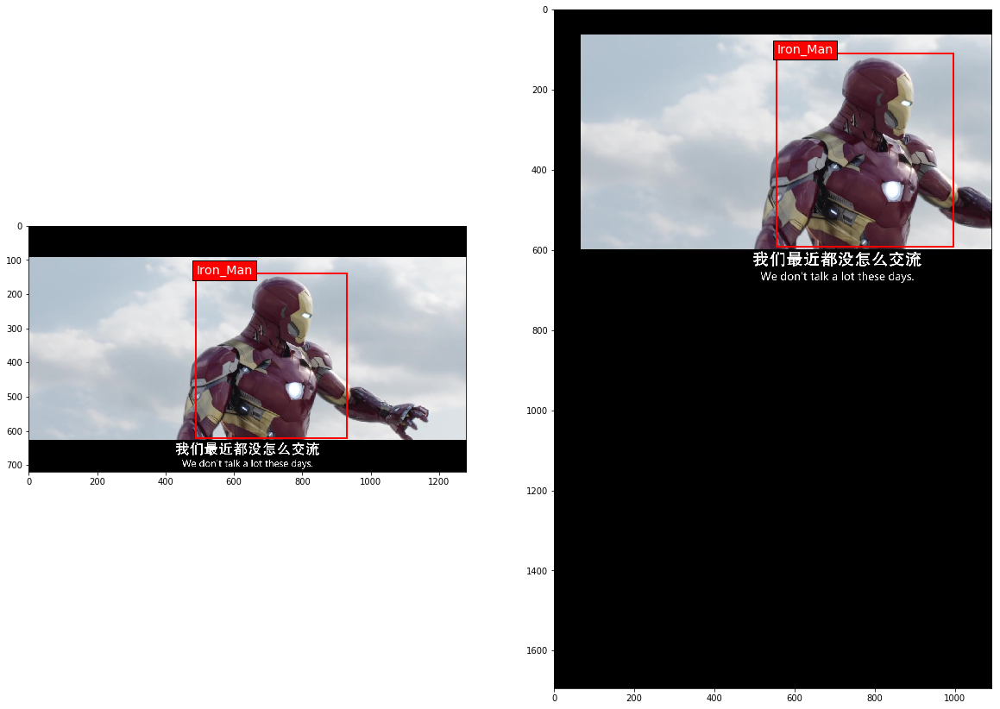

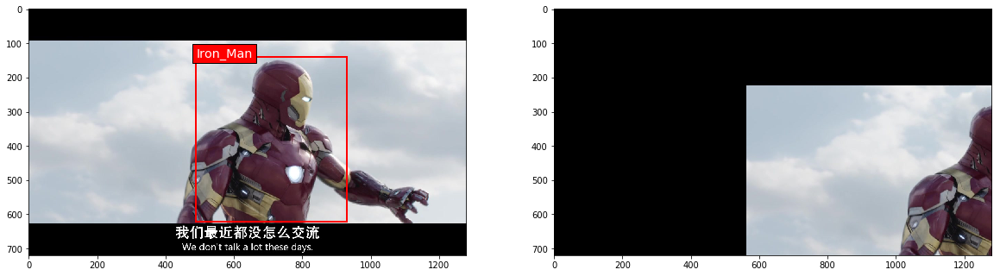

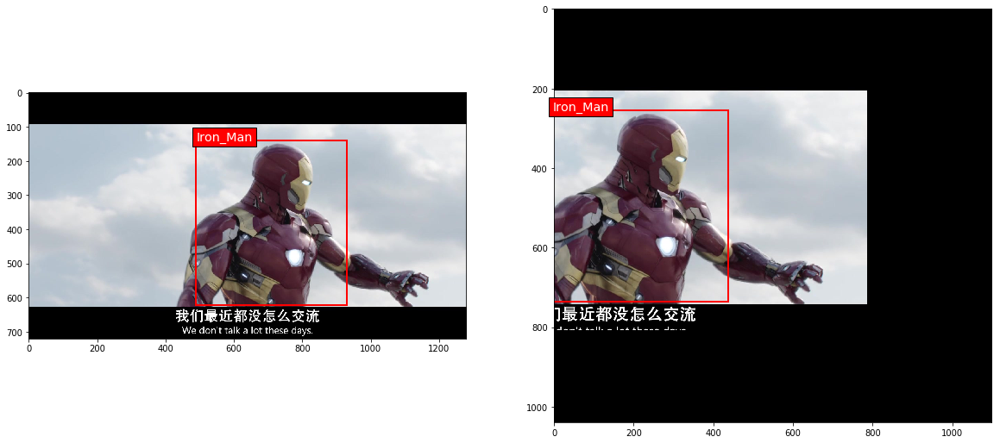

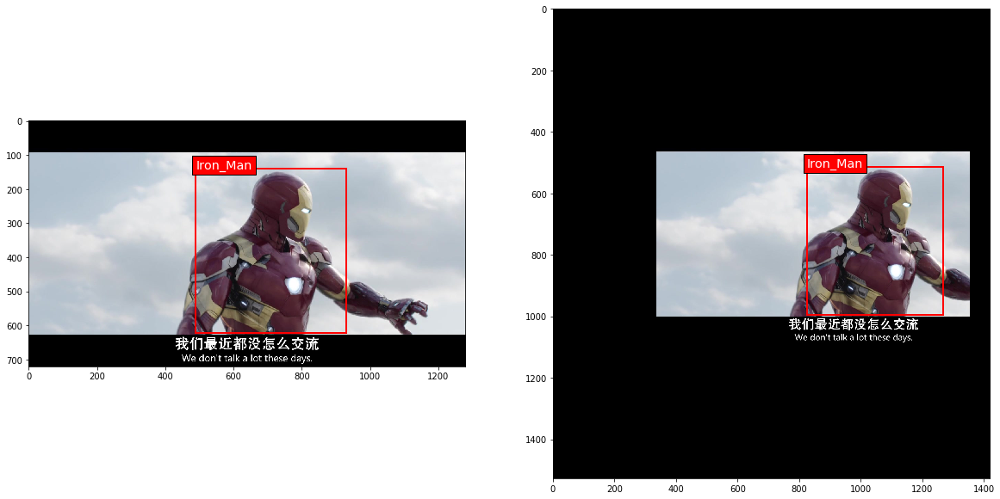

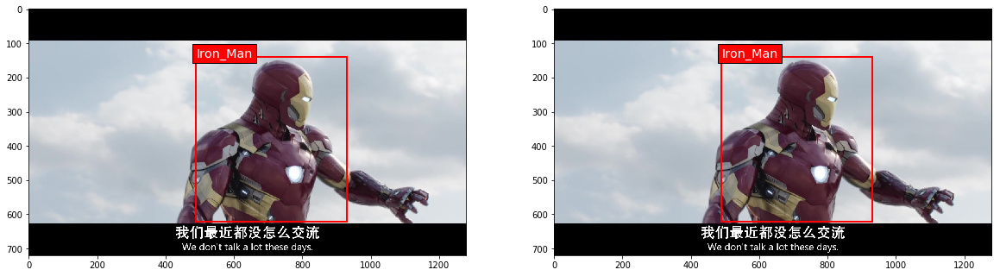

...

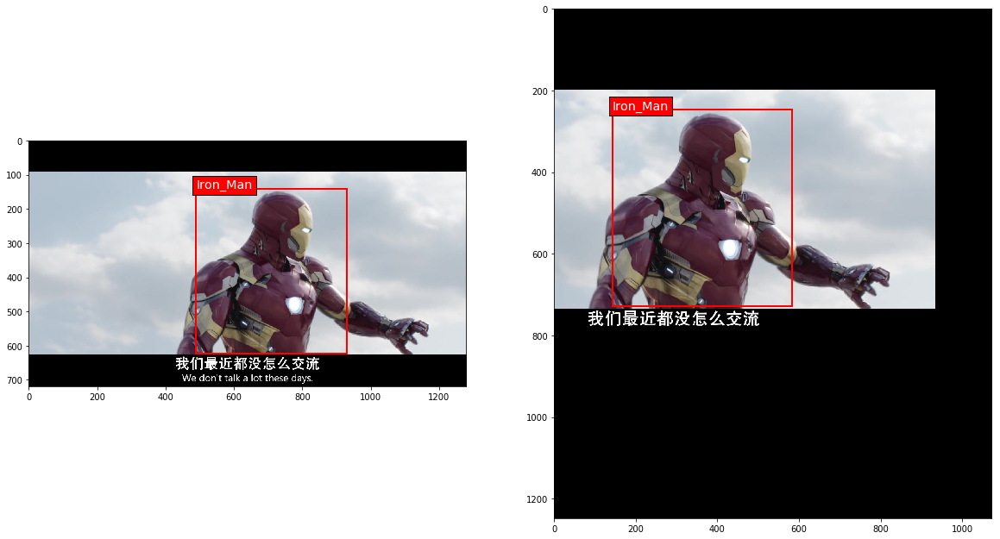

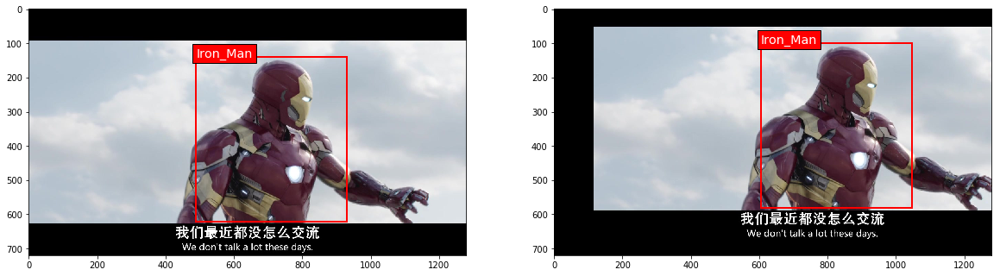

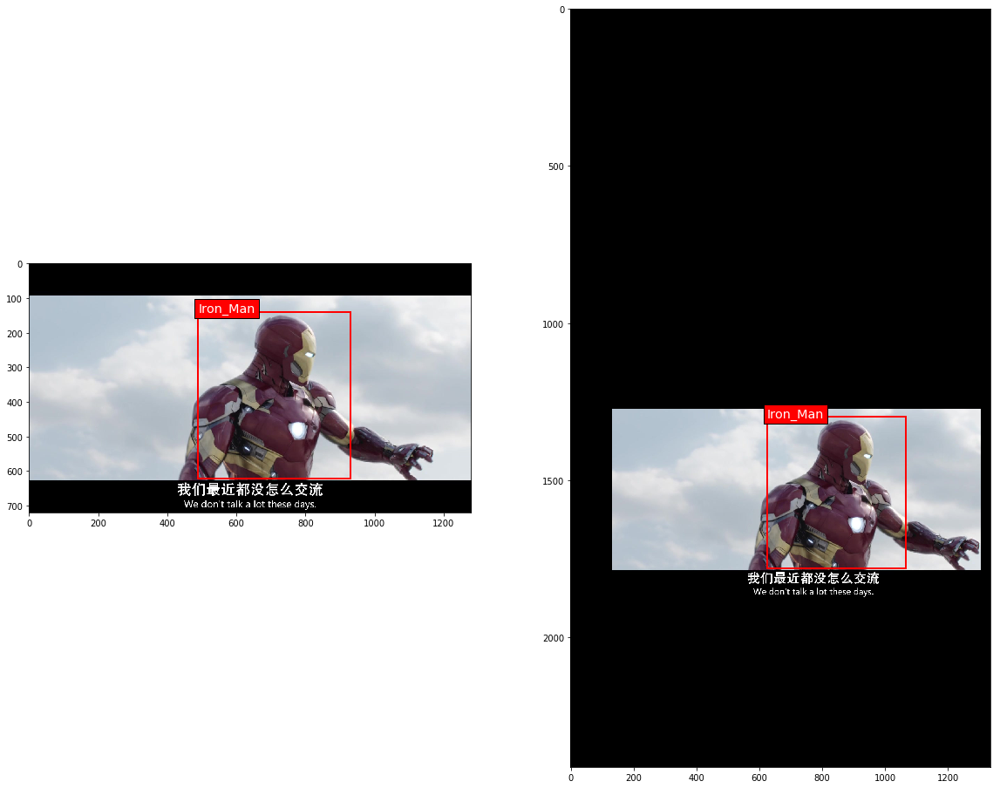

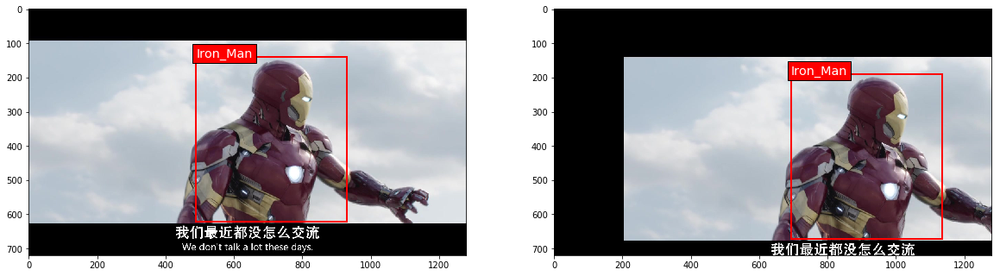

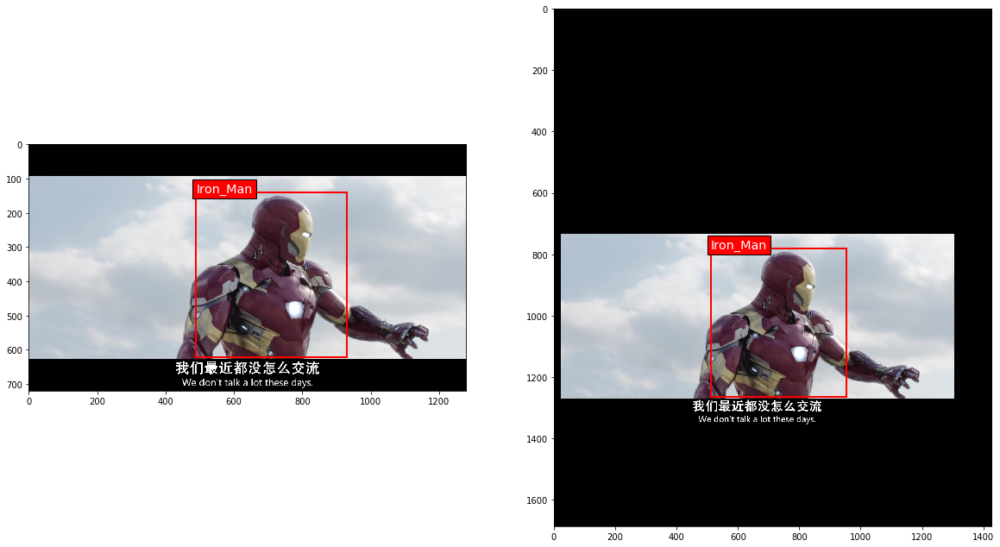

In [22]:
import pandas as pd
import cv2

labels = []
label_num = 2000
class_num = [0]*8


nname = 0
i = 0
while True:
    processed_images, processed_annotations, filenames, original_images, original_annotations = next(data_generator)
    for j in range(len(processed_images)):
        flg = False
        for a in processed_annotations[j]:
            if class_num[a[0]] >= label_num:
                flg = False
                break
            if class_num[a[0]] < label_num: flg = True

        if flg:
            img = np.array(processed_images[j])
            cv2.imwrite(image_gen_dir + str(nname) + ".jpg", img)
            for a in processed_annotations[j]:
                class_num[a[0]] += 1
                labels.append([str(nname)+".jpg", img.shape[1], img.shape[0], classes[a[0]], a[1], a[2], a[3], a[4]]) 
            nname += 1

    print(i)
    i += 1
    if i >= 50: break

# print("finished", nname, "images\n\n")
# column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
# xml_df = pd.DataFrame(labels, columns=column_name)
# xml_df.to_csv('/home/omr/Desktop/LABEL_DONE/train_labels.csv', index=None)

# lll = []
# for i, n in enumerate(class_num):
#     print(classes[i], ':', n)
#     lll.append([classes[i], n])
    
# lll_df = pd.DataFrame(lll)
# lll_df.to_csv('/home/omr/Desktop/LABEL_DONE/data.csv', index=None)

In [15]:
processed_images, processed_annotations, filenames, original_images, original_annotations = next(data_generator)
        

(720, 1280, 3)
(1630, 1353, 3)


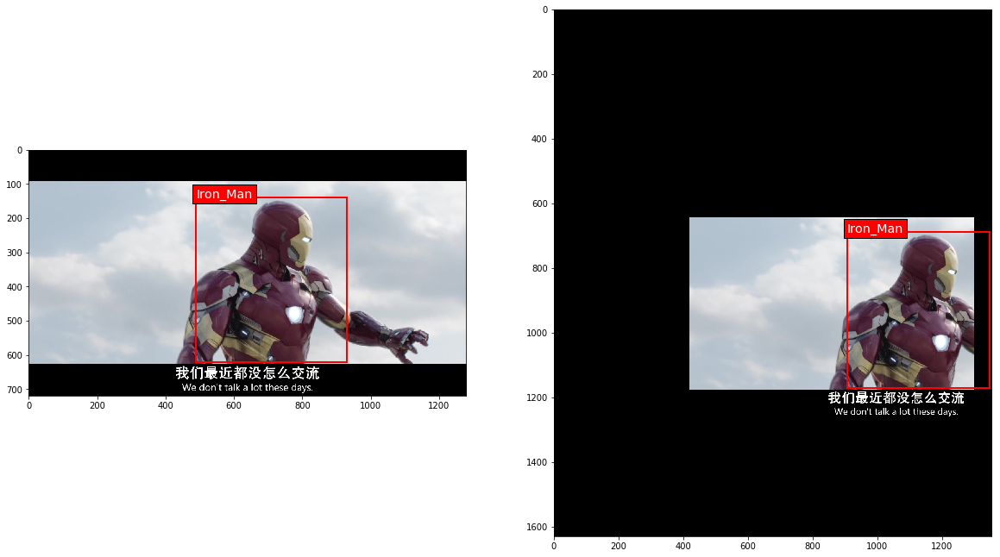

In [19]:
i = 0
colors = plt.cm.hsv(np.linspace(0, 1, len(classes))).tolist() # Set the colors for the bounding boxes

fig, cell = plt.subplots(1, 2, figsize=(20,16))
cell[0].imshow(original_images[i])
cell[1].imshow(processed_images[i])
print(original_images[i].shape)
print(processed_images[i].shape)
for box in original_annotations[i]:
    xmin = box[1]
    ymin = box[2]
    xmax = box[3]
    ymax = box[4]
    color = colors[int(box[0])]
    label = '{}'.format(classes[int(box[0])])
    cell[0].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
    cell[0].text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})
    
for box in processed_annotations[i]:
    xmin = box[1]
    ymin = box[2]
    xmax = box[3]
    ymax = box[4]
    color = colors[int(box[0])]
    label = '{}'.format(classes[int(box[0])])
    cell[1].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
    cell[1].text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})

The first two arguments here are the same as for `BoxFilter`. The third argument, `n_boxes_min`, determines the minimum number of bounding boxes that need to meet the criteria in order for the transformed image to be accepted as valid. This particular `ImageValidator` object would accept a transformed image if at least one bounding box would have at least 0.3 of its area overlap with the transformed image.

Note that in the arguments of the `RandomTranslate` constructor, you pass both a `BoxFilter` and an `ImageValidator` object. This means the criteria by which the transformation decides which boxes to keep are not necessarily the same criteria as those by which the transformation decides whether a given transformed image is valid. This provides great flexibility, and in one of the next sections we'll see an example of a very successful object detection model that actually uses different criteria for box filtering and image validation in its data augmentation pipeline.

Of course `BoxFilter` and `ImageValidator` objects aren't relevant for all image transformations. For example, if you flip an image, the flipped image is guaranteed to fully contain all bounding boxes just as before the flip. Or if you apply photometric transformations to an image, its annotations don't even change at all. These transformations don't take `BoxFilter` or `ImageValidator` objects in their arguments because there is nothing to filter or validate.

### 1.4. Put together a data augmentation pipeline

The previous section was just foreplay to introduce you to how image transformations generally work by means of a concrete example.

Now we'll put together a real pipeline for image pre-processing and data augmentation. We'll first create the objects for all the transformations and then well arrange them in a list to produce our processing chain.

In [23]:
# Utility transformations
convert_to_3_channels = ConvertTo3Channels() # Make sure all images end up having 3 channels.
convert_RGB_to_HSV    = ConvertColor(current='RGB', to='HSV')
convert_HSV_to_RGB    = ConvertColor(current='HSV', to='RGB')
convert_to_float32    = ConvertDataType(to='float32')
convert_to_uint8      = ConvertDataType(to='uint8')
resize                = Resize(height=300, width=300)

# Photometric transformations
random_brightness     = RandomBrightness(lower=-48, upper=48, prob=0.5)
random_contrast       = RandomContrast(lower=0.5, upper=1.5, prob=0.5)
random_saturation     = RandomSaturation(lower=0.5, upper=1.5, prob=0.5)
random_hue            = RandomHue(max_delta=18, prob=0.5)

# Geometric transformations
random_flip           = RandomFlip(dim='horizontal', prob=0.5)
patch_coord_generator = PatchCoordinateGenerator(must_match='w_ar',
                                                 min_scale=0.3,
                                                 max_scale=2.0,
                                                 scale_uniformly=False,
                                                 min_aspect_ratio = 0.5,
                                                 max_aspect_ratio = 2.0)
random_patch          = RandomPatch(patch_coord_generator=patch_coord_generator,
                                    box_filter=box_filter,
                                    image_validator=image_validator,
                                    n_trials_max=10,
                                    clip_boxes=False,
                                    prob=1.0,
                                    can_fail=False)
# Define the processing chain
data_augmentation = [convert_to_3_channels,
                     convert_to_float32,
                     random_brightness,
                     random_contrast,
                     convert_to_uint8,
                     convert_RGB_to_HSV,
                     convert_to_float32,
                     random_saturation,
                     random_hue,
                     convert_to_uint8,
                     convert_HSV_to_RGB,
                     random_patch,
                     random_flip,
                     resize]

There's a lot happening in the code cell above. Let's break it down.

First, we're defining a bunch of utility transformations:
* `ConvertTo3Channels`: Regardless of which deep learning framework you're using, images within the same batch must always have the same shape, which means they must also have the same number of color channels. Some datasets contain a mix of 3-channel (e.g. RGB) and single-channel images. Some datasets might even contain a mix of 3-channel, 1-channel, and 4-channel images. This transformations converts any image to 3 channels if it isn't a 3-channel image already. This is basically just a safety transformation that we will put at the very beginning of our processing chain. If we were 100% certain that all images in our dataset had the same number of channels, we could omit this safety transformation, but often you aren't 100% certain.
* `ConvertColor`: Some of the photometric transformations require the images to be in RGB and others in HSV, so we need color space transformations to convert accordingly between these two color spaces.
* `ConvertDataType`: Some of the photometric transformations require the images to be in `float32` format, while some OpenCV functions like `cvtColor()` require the images to be in `uint8` format, so we need transformations to convert between those two datatypes.
* `Resize`: As mentioned above, images within the same batch must always have the same shape. The images in the Pascal VOC datasets have varying sizes, therefore we need to resize them to a fixed size. In our particular processing chain, this is not directly the reason why we need a resizing transformation though. We're sampling random patches of varying sizes and aspect ratios from the input images, so we need to resize those randomly sampled patches to a fixed size at the end. This resizing of images of varying aspect ratios has an intended side effect: It introduces random deformation. Some images will be stretched in one dimension and compressed in the other, etc. As long as the deformed objects are still recognizable, slight deformations are usually highly desirable in order to improve a model's ability to generalize.

Next, we're defining a bunch of photometric distortions:
* `RandomBrightness`: Randomly increases or reduces the brightness of images.
* `RandomContrast`: Randomly increases or reduces the contrast of images.
* `RandomSaturation`: Randomly increases or reduces the saturation of images.
* `RandomHue`: Randomly changes the hue of images.

Next, we're defining a few geometric transformations:
* `RandomFlip`: Randomly flips images, in our case horizontally.
* `RandomPatch`: Samples random patches from the input images according to the specifications defined in the `PatchCoordinateGenerator` (see below). Note that the `RandomPatch` transformation uses the box filter and image validator we defined earlier.
* `PatchCoordinateGenerator`: This is not a transformation. It's an object that generates random coordinates for patches according to specified criteria, and it is being passed to the `RandomPatch` constructor. In our example, the generated patches have an aspect ratio between 0.5 and 2.0 and their width is between 0.3 and 2.0 of the width of the input image. Note that this means that the generated patches can be larger than the input image in one or both spatial dimensions. This has a scaling effect: Patches that are smaller than the respective input image act as a "zoom-in" operation, while patches that are larger than the respective input image act as a "zoom-out" operation. In general, this `PatchCoordinateGenerator` makes the `RandomPatch` transformation ultimately flexible because it can produce random patches that meet any conceivable criteria.

Finally, we're arranging all of these transformations in an order that makes sense. This is certainly not the only order that would make sense, but it is one sensible order.

Let's look at the results of our data augmentation pipeline. For one last time, don't worry about the `generate()` method in the next code cell, we'll get to that in a moment. For now we just quickly want to flip through a few transformed images to visualize what our processing chain does.

In [24]:
batch_size = 1

data_generator = dataset.generate(batch_size=batch_size,
                                  shuffle=False,
                                  transformations=data_augmentation,
                                  label_encoder=None,
                                  returns={'processed_images',
                                           'processed_labels',
                                           'filenames',
                                           'original_images',
                                           'original_labels'},
                                  keep_images_without_gt=False)

In [25]:
processed_images, processed_annotations, filenames, original_images, original_annotations = next(data_generator)

i = 0 # Which batch item to look at


print("Image:", filenames[i])
print()
print("Original ground truth boxes:\n")
print(np.array(original_annotations[i]))

Image: /home/omr/Desktop/LABEL_DONE/images/IMG_7804_0_10.jpg

Original ground truth boxes:

[[ 59  18  62  39 114]
 [ 58 125  73 163 105]]


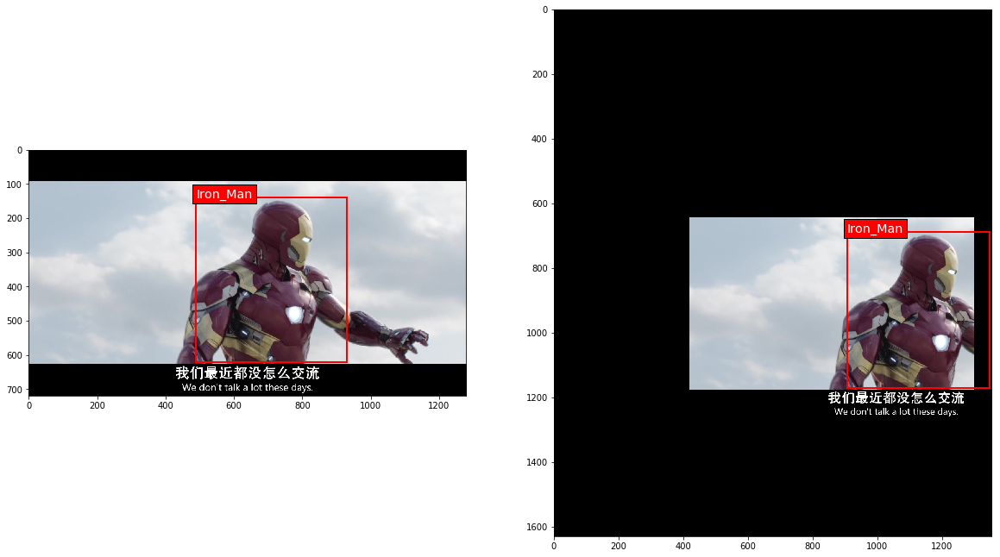

In [20]:
colors = plt.cm.hsv(np.linspace(0, 1, len(classes))).tolist() # Set the colors for the bounding boxes

fig, cell = plt.subplots(1, 2, figsize=(20,16))
cell[0].imshow(original_images[i])
cell[1].imshow(processed_images[i])

for box in original_annotations[i]:
    xmin = box[1]
    ymin = box[2]
    xmax = box[3]
    ymax = box[4]
    color = colors[int(box[0])]
    label = '{}'.format(classes[int(box[0])])
    cell[0].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
    cell[0].text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})
    
for box in processed_annotations[i]:
    xmin = box[1]
    ymin = box[2]
    xmax = box[3]
    ymax = box[4]
    color = colors[int(box[0])]
    label = '{}'.format(classes[int(box[0])])
    cell[1].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
    cell[1].text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})